In [31]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter
import string

In [11]:
df = pd.read_csv("catalog.csv")

C:\Users\xraef\AppData\Local\Temp\ipykernel_10428\355666602.py:1: DtypeWarning: Columns (8) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv("catalog.csv")


In [12]:
df

,Text#,Type,Issued,Title,Language,Authors,Subjects,LoCC,Bookshelves
0,1,Text,1971-12-01,The Declaration of Independence of the United ...,en,"Jefferson, Thomas, 1743-1826","United States -- History -- Revolution, 1775-1...",E201; JK,Politics; American Revolutionary War; United S...
1,2,Text,1972-12-01,The United States Bill of Rights\r\nThe Ten Or...,en,United States,Civil rights -- United States -- Sources; Unit...,JK; KF,Politics; American Revolutionary War; United S...
2,3,Text,1973-11-01,John F. Kennedy's Inaugural Address,en,"Kennedy, John F. (John Fitzgerald), 1917-1963",United States -- Foreign relations -- 1961-196...,E838,NaN
3,4,Text,1973-11-01,Lincoln's Gettysburg Address\r\nGiven November...,en,"Lincoln, Abraham, 1809-1865",Consecration of cemeteries -- Pennsylvania -- ...,E456,US Civil War
4,5,Text,1975-12-01,The United States Constitution,en,United States,United States -- Politics and government -- 17...,JK; KF,United States; Politics; American Revolutionar...
...,...,...,...,...,...,...,...,...,...
71272,71353,Text,2023-08-06,The four Corners in California,en,"Blanchard, Amy Ella, 1856-1926",NaN,NaN,NaN
71273,71354,Text,2023-08-06,Auf Schneeschuhen durch Grönland. Erster Band,de,"Nansen, Fridtjof, 1861-1930; Mann, M. [Transla...",NaN,NaN,NaN
71274,71355,Text,2023-08-06,Auf Schneeschuhen durch Grönland. Zweiter Band,de,"Nansen, Fridtjof, 1861-1930; Mann, M. [Transla...",NaN,NaN,NaN
71275,71356,Text,2023-08-06,Le chevalier de Maison-Rouge,en,"Dumas, Alexandre, 1802-1870",NaN,NaN,NaN


In [13]:
df = df[["Title","Language","Subjects","Bookshelves"]]

In [14]:
df["Language"].unique()

array(['en', 'la', 'es', 'de; en', 'de; la', 'fr', 'it', 'ja', 'de',
       'en; zh', 'sv', 'da', 'cy', 'bg', 'en; fr', 'pt', 'nl', 'el', 'zh',
       'he', 'en; es', 'ru', 'en; hu', 'en; ko', 'pl', 'fi', 'en; la',
       'en; eo', 'en; enm', 'eo', 'en; sv', 'sa', 'en; ang', 'cy; en',
       'en; ale', 'yi', 'lt', 'es; nai', 'sr', 'no', 'ca; de', 'ro',
       'en; nah', 'en; kha', 'cs', 'tl', 'en; it', 'ca', 'is', 'de; fr',
       'myn', 'fr; nai', 'es; tl', 'ilo', 'ia', 'en; es; tl', 'ga',
       'es; ilo', 'fur', 'af', 'en; kld', 'enm', 'oc', 'fr; it', 'nap',
       'hu', 'la; nl', 'fy', 'fr; la', 'en; myn', 'ceb', 'gl', 'nah',
       'mi', 'en; nav', 'br', 'arp', 'cs; eo', 'en; es; fr', 'iu',
       'es; bgs', 'fr; pl', 'pl; csb', 'en; pt', 'gla', 'da; en', 'rmr',
       'fr; el', 'la; el', 'en; nai', 'fr; pt', 'de; fur', 'sl', 'de; nl',
       'te', 'oji', 'en; el', 'fr; nl', 'en; ceb', 'en; grc', 'en; mi',
       'ar', 'et', 'de; ang', 'fa', 'en; brx', 'de; eo', 'es; fr; myn',
   

<Axes: xlabel='Language', ylabel='count'>

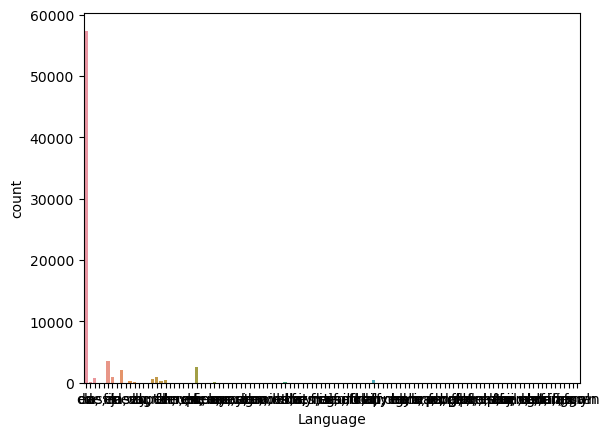

In [15]:
sns.countplot(x='Language', data=df)

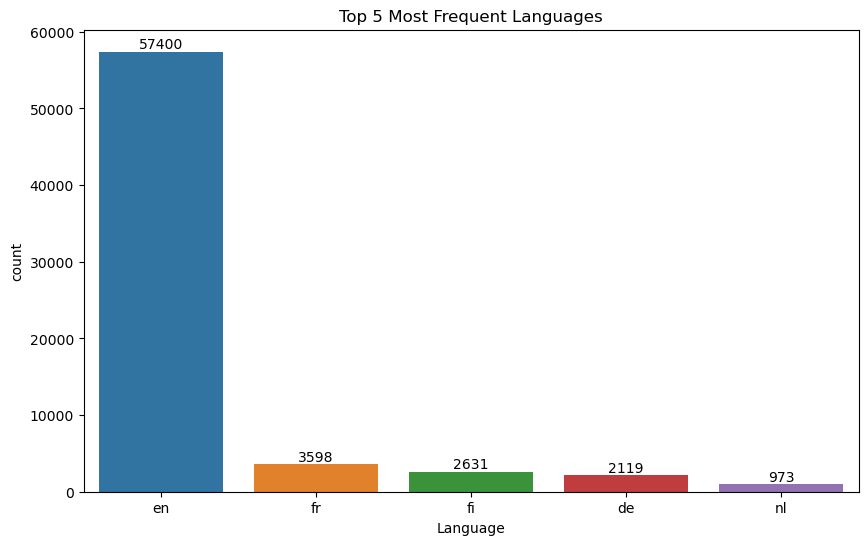

In [17]:
# 1. Find top 5 most frequent languages
top_languages = df['Language'].value_counts().head(5).index

# 2. Filter DataFrame
filtered_df = df[df['Language'].isin(top_languages)]

# 3. Plot a countplot using Seaborn
plt.figure(figsize=(10, 6))
ax = sns.countplot(data=filtered_df, x='Language', order=top_languages)
plt.title('Top 5 Most Frequent Languages')

# Display counts on the plot
for p in ax.patches:
    ax.annotate(f'{int(p.get_height())}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 5),
                textcoords='offset points')

plt.show()

In [18]:
df = df[df["Language"] == "en"]

In [20]:
df.head()

,Title,Language,Subjects,Bookshelves
0,The Declaration of Independence of the United ...,en,"United States -- History -- Revolution, 1775-1...",Politics; American Revolutionary War; United S...
1,The United States Bill of Rights\r\nThe Ten Or...,en,Civil rights -- United States -- Sources; Unit...,Politics; American Revolutionary War; United S...
2,John F. Kennedy's Inaugural Address,en,United States -- Foreign relations -- 1961-196...,NaN
3,Lincoln's Gettysburg Address\r\nGiven November...,en,Consecration of cemeteries -- Pennsylvania -- ...,US Civil War
4,The United States Constitution,en,United States -- Politics and government -- 17...,United States; Politics; American Revolutionar...


In [21]:
df.drop(columns=['Language'], inplace=True)

In [22]:
df.head()

,Title,Subjects,Bookshelves
0,The Declaration of Independence of the United ...,"United States -- History -- Revolution, 1775-1...",Politics; American Revolutionary War; United S...
1,The United States Bill of Rights\r\nThe Ten Or...,Civil rights -- United States -- Sources; Unit...,Politics; American Revolutionary War; United S...
2,John F. Kennedy's Inaugural Address,United States -- Foreign relations -- 1961-196...,NaN
3,Lincoln's Gettysburg Address\r\nGiven November...,Consecration of cemeteries -- Pennsylvania -- ...,US Civil War
4,The United States Constitution,United States -- Politics and government -- 17...,United States; Politics; American Revolutionar...


In [23]:
for index, row in df.iterrows():
    print("Title:", row['Title'])
    print("Subjects:", row['Subjects'])
    
    # Check if the Bookshelves value is not NaN before printing
    if not pd.isna(row['Bookshelves']):
        print("Bookshelves:", row['Bookshelves'])
    else:
        print("Bookshelves: Not Available")
    
    print("------")


Title: The Declaration of Independence of the United States of America
Subjects: United States -- History -- Revolution, 1775-1783 -- Sources; United States. Declaration of Independence
Bookshelves: Politics; American Revolutionary War; United States Law
------
Title: The United States Bill of Rights
The Ten Original Amendments to the Constitution of the United States
Subjects: Civil rights -- United States -- Sources; United States. Constitution. 1st-10th Amendments
Bookshelves: Politics; American Revolutionary War; United States Law
------
Title: John F. Kennedy's Inaugural Address
Subjects: United States -- Foreign relations -- 1961-1963; Presidents -- United States -- Inaugural addresses
Bookshelves: Not Available
------
Title: Lincoln's Gettysburg Address
Given November 19, 1863 on the battlefield near Gettysburg, Pennsylvania, USA
Subjects: Consecration of cemeteries -- Pennsylvania -- Gettysburg; Soldiers' National Cemetery (Gettysburg, Pa.); Lincoln, Abraham, 1809-1865. Gettysb

In [24]:
df = df.drop_duplicates(subset='Title')

In [25]:
for index, row in df.iterrows():
    print("Title:", row['Title'])
    print("Subjects:", row['Subjects'])
    
    # Check if the Bookshelves value is not NaN before printing
    if not pd.isna(row['Bookshelves']):
        print("Bookshelves:", row['Bookshelves'])
    else:
        print("Bookshelves: Not Available")
    
    print("------")

Title: The Declaration of Independence of the United States of America
Subjects: United States -- History -- Revolution, 1775-1783 -- Sources; United States. Declaration of Independence
Bookshelves: Politics; American Revolutionary War; United States Law
------
Title: The United States Bill of Rights
The Ten Original Amendments to the Constitution of the United States
Subjects: Civil rights -- United States -- Sources; United States. Constitution. 1st-10th Amendments
Bookshelves: Politics; American Revolutionary War; United States Law
------
Title: John F. Kennedy's Inaugural Address
Subjects: United States -- Foreign relations -- 1961-1963; Presidents -- United States -- Inaugural addresses
Bookshelves: Not Available
------
Title: Lincoln's Gettysburg Address
Given November 19, 1863 on the battlefield near Gettysburg, Pennsylvania, USA
Subjects: Consecration of cemeteries -- Pennsylvania -- Gettysburg; Soldiers' National Cemetery (Gettysburg, Pa.); Lincoln, Abraham, 1809-1865. Gettysb

In [28]:
df.drop(columns=['Bookshelves'], inplace=True)

In [29]:
df.head()

,Title,Subjects
0,The Declaration of Independence of the United ...,"United States -- History -- Revolution, 1775-1..."
2,John F. Kennedy's Inaugural Address,United States -- Foreign relations -- 1961-196...
3,Lincoln's Gettysburg Address\r\nGiven November...,Consecration of cemeteries -- Pennsylvania -- ...
4,The United States Constitution,United States -- Politics and government -- 17...
5,Give Me Liberty or Give Me Death,"Speeches, addresses, etc., American; United St..."


In [32]:
# Tokenize the subjects and count word frequencies
word_counter = Counter()

for subject in df['Subjects']:
    # Remove punctuation, convert to lowercase, and split into words
    tokens = subject.translate(str.maketrans('', '', string.punctuation)).lower().split()
    word_counter.update(tokens)

# Display the most common words
most_common_words = word_counter.most_common()
print(most_common_words)

[('fiction', 707), ('and', 192), ('history', 166), ('periodicals', 157), ('juvenile', 143), ('stories', 115), ('states', 97), ('united', 96), ('war', 81), ('poetry', 80), ('literature', 79), ('english', 75), ('of', 70), ('england', 60), ('century', 50), ('to', 50), ('american', 48), ('life', 48), ('great', 46), ('britain', 46), ('character', 45), ('science', 44), ('travel', 43), ('early', 42), ('tales', 41), ('world', 40), ('works', 40), ('fictitious', 39), ('drama', 39), ('biography', 38), ('description', 36), ('1800', 36), ('america', 34), ('translations', 33), ('into', 33), ('19th', 33), ('19141918', 33), ('north', 31), ('women', 31), ('childrens', 27), ('indians', 27), ('africa', 27), ('france', 25), ('social', 25), ('adventure', 24), ('african', 24), ('india', 24), ('new', 23), ('folklore', 23), ('civil', 21), ('south', 21), ('relations', 20), ('church', 20), ('historical', 20), ('germany', 20), ('customs', 19), ('animals', 19), ('etc', 18), ('18611865', 18), ('humor', 17), ('shor

In [33]:
# Filter words where frequency is 5 or more
filtered_word_freqs = [(word, freq) for word, freq in most_common_words if freq >= 5]

print(filtered_word_freqs)

[('fiction', 707), ('and', 192), ('history', 166), ('periodicals', 157), ('juvenile', 143), ('stories', 115), ('states', 97), ('united', 96), ('war', 81), ('poetry', 80), ('literature', 79), ('english', 75), ('of', 70), ('england', 60), ('century', 50), ('to', 50), ('american', 48), ('life', 48), ('great', 46), ('britain', 46), ('character', 45), ('science', 44), ('travel', 43), ('early', 42), ('tales', 41), ('world', 40), ('works', 40), ('fictitious', 39), ('drama', 39), ('biography', 38), ('description', 36), ('1800', 36), ('america', 34), ('translations', 33), ('into', 33), ('19th', 33), ('19141918', 33), ('north', 31), ('women', 31), ('childrens', 27), ('indians', 27), ('africa', 27), ('france', 25), ('social', 25), ('adventure', 24), ('african', 24), ('india', 24), ('new', 23), ('folklore', 23), ('civil', 21), ('south', 21), ('relations', 20), ('church', 20), ('historical', 20), ('germany', 20), ('customs', 19), ('animals', 19), ('etc', 18), ('18611865', 18), ('humor', 17), ('shor

In [34]:
# Approach 2: Stop word removal
stop_words = set(['and', 'of', 'the', 'in', 'to', 'a', 'for', 'on', 'is', 'with', 'by', 'as', 'an', 'or', 'at', 'from', 'it', 'be', 'this', 'that', 'which', 'but'])

filtered_subjects_2 = [word for word, freq in filtered_word_freqs if word not in stop_words]
print("Filtered using stop word removal:", filtered_subjects_2)

Filtered using stop word removal: ['fiction', 'history', 'periodicals', 'juvenile', 'stories', 'states', 'united', 'war', 'poetry', 'literature', 'english', 'england', 'century', 'american', 'life', 'great', 'britain', 'character', 'science', 'travel', 'early', 'tales', 'world', 'works', 'fictitious', 'drama', 'biography', 'description', '1800', 'america', 'translations', 'into', '19th', '19141918', 'north', 'women', 'childrens', 'indians', 'africa', 'france', 'social', 'adventure', 'african', 'india', 'new', 'folklore', 'civil', 'south', 'relations', 'church', 'historical', 'germany', 'customs', 'animals', 'etc', '18611865', 'humor', 'short', 'birds', 'religion', 'fairy', 'fantasy', 'psychological', 'children', 'horror', 'bible', 'foreign', 'americans', 'canada', 'mystery', 'psychology', 'sources', 'british', 'christian', 'mythology', 'political', 'humorous', 'detective', 'animal', 'plants', 'imaginary', 'language', 'medicine', 'love', 'australia', 'natural', 'ireland', 'greece', 'epi

In [36]:
from transformers import BertTokenizer, BertModel
import torch
import numpy as np

# Load BERT model and tokenizer
model_name = 'bert-base-uncased'
model = BertModel.from_pretrained(model_name)
tokenizer = BertTokenizer.from_pretrained(model_name)

# Vectorize words using BERT
def get_bert_embedding(word):
    inputs = tokenizer(word, return_tensors="pt")
    with torch.no_grad():
        output = model(**inputs)
    return output['last_hidden_state'][:,0,:].numpy()

words = [word for word, _ in filtered_word_freqs]
word_vectors = [get_bert_embedding(word) for word in words]
word_vectors = np.array(word_vectors).squeeze()


Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertModel: ['cls.predictions.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.seq_relationship.weight', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.LayerNorm.weight']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


c:\Users\xraef\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\xraef\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
c:\Users\xraef\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\xraef\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are

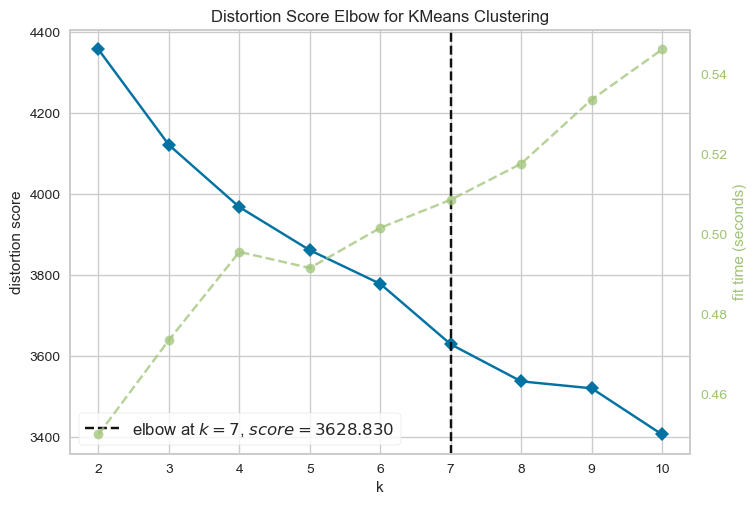

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [41]:
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer
# Determine optimal number of clusters
kmeans = KMeans(random_state=42)
elbow_graph = KElbowVisualizer(KMeans(), k=10)
elbow_graph.fit(word_vectors)
elbow_graph.show()

In [42]:
optimal_clusters = 7 # Replace this with the number you observe from the elbow method
kmeans = KMeans(n_clusters=optimal_clusters)
kmeans.fit(word_vectors)

clusters = {i: [] for i in range(optimal_clusters)}

for word, label in zip(words, kmeans.labels_):
    clusters[label].append(word)

for label, cluster_words in clusters.items():
    print(f"Cluster {label + 1}:", cluster_words)


c:\Users\xraef\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\xraef\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Cluster 1: ['women', 'men', 'girls', 'boys']
Cluster 2: ['and', 'periodicals', 'to', 'life', 'works', '1800', '19th', '19141918', 'north', 'childrens', 'new', 'south', 'relations', '18611865', 'short', 'psychological', 'humorous', 'animal', 'cooking', 'art', 'pirates', 'gothic', 'modern', '18th', 'conduct', 'satire', 'ethics', '17751783', 'constitutional', 'persons', 'triangles', 'interpersonal', 'evolution', 'married', 'didactic', 'bc']
Cluster 3: ['history', 'literature', 'english', 'fictitious', 'drama', 'folklore', 'historical', 'customs', 'religion', 'foreign', 'psychology', 'political', 'medicine', 'french', 'knighthood', 'philosophy', 'law', 'biology', 'politics', 'photography', 'latin', 'economics', 'hygiene', 'architecture']
Cluster 4: ['fiction', 'juvenile', 'states', 'poetry', 'england', 'american', 'britain', 'science', 'biography', 'description', 'africa', 'france', 'india', 'germany', 'animals', 'birds', 'children', 'americans', 'canada', 'sources', 'british', 'plants', '

QhullError: QH6214 qhull input error: not enough points(1) to construct initial simplex (need 3)

While executing:  | qhull i Qt
Options selected for Qhull 2019.1.r 2019/06/21:
  run-id 1489207539  incidence  Qtriangulate  _pre-merge  _zero-centrum
  _maxoutside  0


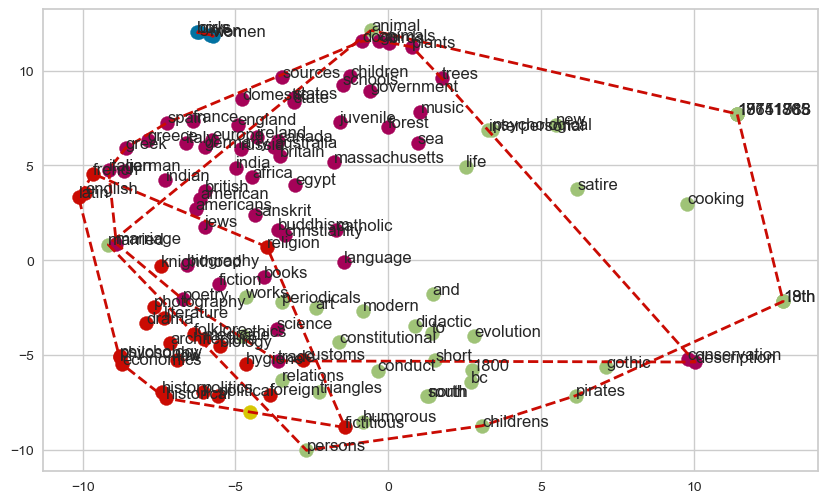

In [43]:
from sklearn.manifold import TSNE
from scipy.spatial import ConvexHull
import matplotlib.pyplot as plt

# Reduce dimensions using t-SNE
tsne = TSNE(n_components=2, random_state=0)
word_vectors_2d = tsne.fit_transform(word_vectors)

# Scatter plot
plt.figure(figsize=(10, 6))

for label in range(optimal_clusters):
    indices = [i for i, l in enumerate(kmeans.labels_) if l == label]
    subset = word_vectors_2d[indices]
    
    # Draw the cluster points
    plt.scatter(subset[:, 0], subset[:, 1], s=100, label=f'Cluster {label + 1}')
    
    # Draw the Convex Hull
    hull = ConvexHull(subset)
    plt.plot(np.append(subset[hull.vertices,0], subset[hull.vertices,0][0]), 
             np.append(subset[hull.vertices,1], subset[hull.vertices,1][0]), 
             'r--', lw=2)

    # Annotate with words
    for i, word in zip(indices, np.array(words)[indices]):
        plt.annotate(word, (word_vectors_2d[i, 0], word_vectors_2d[i, 1]))

plt.title('t-SNE Visualization of Word Clusters')
plt.legend()
plt.show()

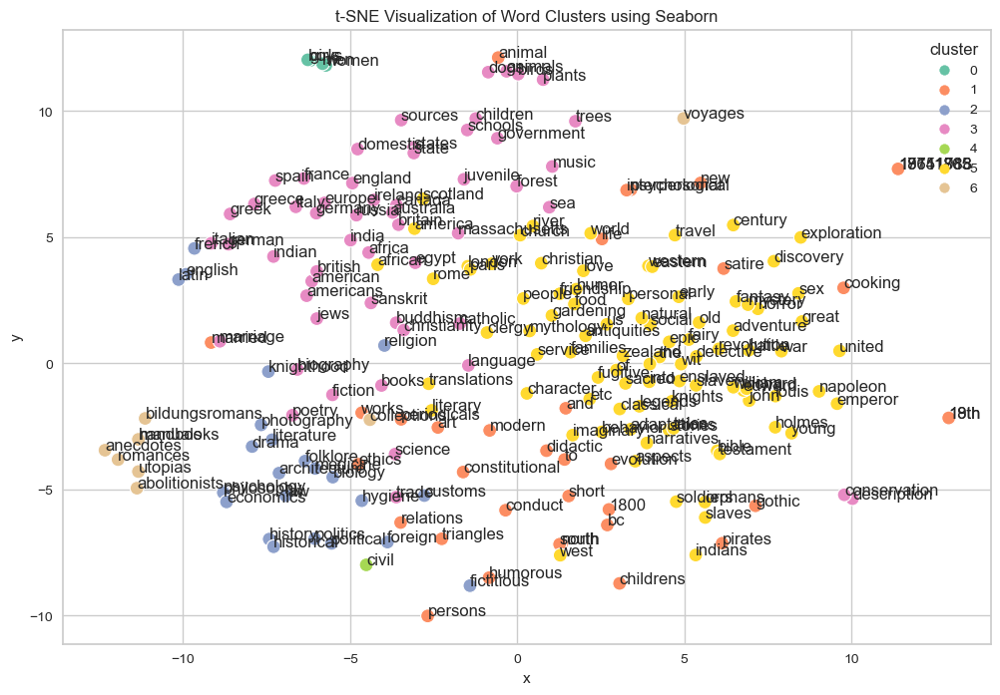

In [44]:
import seaborn as sns

# Reduce dimensions using t-SNE
tsne = TSNE(n_components=2, random_state=0)
word_vectors_2d = tsne.fit_transform(word_vectors)

# Create a DataFrame for the t-SNE results
df_tsne = pd.DataFrame(word_vectors_2d, columns=["x", "y"])
df_tsne["word"] = words
df_tsne["cluster"] = kmeans.labels_

# Plot using sns.scatterplot
plt.figure(figsize=(12, 8))
sns.scatterplot(x="x", y="y", hue="cluster", data=df_tsne, palette="Set2", s=100, legend="full")

# Annotate points with words
for i, word in enumerate(df_tsne["word"]):
    plt.annotate(word, (df_tsne["x"].iloc[i], df_tsne["y"].iloc[i]))

plt.title('t-SNE Visualization of Word Clusters using Seaborn')
plt.show()
